# Machine learning
## Práctica de evaluación - Pump it Up: Data Mining the Water Table

### Primera aproximación

Comenzamos importando las librerías que utilizaremos

In [1]:
import pandas as pd
pd.set_option("display.max_rows", None, "display.max_columns", None)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from pandas.plotting import scatter_matrix
from sklearn.feature_selection import VarianceThreshold
from sklearn.metrics import accuracy_score, auc, confusion_matrix, f1_score, precision_score, recall_score, roc_curve
from sklearn.feature_selection import SelectKBest
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import cross_val_score
import warnings
warnings.filterwarnings("ignore")

Realizamos la lectura de datos

In [2]:
trn = pd.read_csv(r'Training_set_values.csv', parse_dates=True)
trn_y = pd.read_csv(r'Training_set_labels.csv') 
tst = pd.read_csv(r'Test_set_values.csv', parse_dates=True) 

Unimos los datasets de variables independientes y dependiente de entrenamiento

In [3]:
df = pd.merge(trn, trn_y, on = 'id', how ='inner')

In [4]:
df.head(3)

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional


In [5]:
df['status_group'].value_counts()

functional                 32259
non functional             22824
functional needs repair     4317
Name: status_group, dtype: int64

La variable dependiente está bastante desbalanceada.

Seteamos valores numéricos a nuestra variable objetivo.

In [6]:
df['status_group'] = df['status_group'].apply(lambda x: 1 if x == 'functional' 
                                                           else (0 if x == 'non functional'  
                                                                   else(2)))

Guardamos una copia de test original

In [7]:
test = tst.copy()

Creamos una variable status_group para el dataset de test

In [8]:
tst['status_group']=0

Agregamos un identificador para cada set de datos.

In [9]:
df['trn']=1
tst['trn']=0

Unimos ambos dataframes para el tratamiento de las variables.

In [10]:
df1 = pd.concat([df, tst], ignore_index=True)

In [11]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74250 entries, 0 to 74249
Data columns (total 42 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     74250 non-null  int64  
 1   amount_tsh             74250 non-null  float64
 2   date_recorded          74250 non-null  object 
 3   funder                 69746 non-null  object 
 4   gps_height             74250 non-null  int64  
 5   installer              69718 non-null  object 
 6   longitude              74250 non-null  float64
 7   latitude               74250 non-null  float64
 8   wpt_name               74250 non-null  object 
 9   num_private            74250 non-null  int64  
 10  basin                  74250 non-null  object 
 11  subvillage             73780 non-null  object 
 12  region                 74250 non-null  object 
 13  region_code            74250 non-null  int64  
 14  district_code          74250 non-null  int64  
 15  lg

Vemos que hay variables con bastantes valores missing.

Veamos los estadísticos.

In [12]:
df1.describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year,status_group,trn
count,74250.000000,74250.000000,74250.000000,74250.000000,7.425000e+04,74250.000000,74250.000000,74250.000000,74250.000000,74250.000000,74250.000000,74250.000000
mean,37124.500000,318.685704,665.667313,34.074262,-5.701771e+00,0.462330,15.265414,5.629077,180.750828,1298.463650,0.550747,0.800000
std,21434.273081,2906.762364,692.761033,6.572519,2.944969e+00,11.537879,17.508907,9.641636,471.086120,952.349375,0.603086,0.400003
min,0.000000,0.000000,-90.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,18562.250000,0.000000,0.000000,33.086819,-8.525675e+00,0.000000,5.000000,2.000000,0.000000,0.000000,0.000000,1.000000
50%,37124.500000,0.000000,364.000000,34.907475,-5.026540e+00,0.000000,12.000000,3.000000,25.000000,1986.000000,0.000000,1.000000
75%,55686.750000,20.000000,1317.000000,37.181685,-3.325058e+00,0.000000,17.000000,5.000000,215.000000,2004.000000,1.000000,1.000000
max,74249.000000,350000.000000,2777.000000,40.345193,-2.000000e-08,1776.000000,99.000000,80.000000,30500.000000,2013.000000,2.000000,1.000000


Destaquemos lo siguiente:

   * amount_tsh: valores cero, posibles valores outliers, std demasiado alta.
   * gps_height: valores negativos, cero y posibles outliers, std alta.
   * latitude: valores cero.
   * longitude: valores cero.
   * num_private: valores raros, ver distribución.
   * population: valores cero.
   * construction_year: valores cero.   
    

Clasificamos variables por tipo de dato

In [13]:
lista_numericas=['amount_tsh', 'gps_height', 'longitude', 'latitude', 'num_private', 'region_code', 'district_code',
                'population', 'construction_year']

In [14]:
lista_categoricas=['funder', 'installer', 'wpt_name', 'basin', 'subvillage', 'region', 'lga', 'ward', 'recorded_by', 
                   'scheme_management', 'scheme_name', 'extraction_type', 'extraction_type_group', 'extraction_type_class', 
                   'management', 'management_group', 'payment', 'payment_type', 'water_quality', 'quality_group', 
                   'quantity', 'quantity_group', 'source', 'source_type', 'source_class', 'waterpoint_type', 
                   'waterpoint_type_group']

In [15]:
lista_binarias = ['public_meeting','permit']

Veamos la distribución de nuestras variables numéricas

In [16]:
for i in lista_numericas:
    fig = px.histogram(df1, x=i) 
    fig.show()

Y de las categóricas

In [17]:
for i in lista_categoricas:
    fig = px.bar(df1[i].value_counts(), title=i)
    fig.show()

Y de las binarias

In [18]:
for i in lista_binarias:
    fig = px.bar(df1[i].value_counts(), title=i)
    fig.show()

#### Feature engineering

Corregimos tipo de dato de date_recorded.

In [19]:
df1['date_recorded'] = pd.to_datetime(df1['date_recorded'], infer_datetime_format=True)

Eliminamos variable recorded_by porque tiene un solo valor.

In [20]:
df1.drop(columns=['recorded_by'], inplace=True)

Pasamos a missing valores incorrectos.

In [21]:
df1['amount_tsh'].replace(0, np.nan, inplace=True)
df1['gps_height'] = np.where(df1['gps_height'] <=0, np.nan, df1['gps_height'])
df1['latitude'].replace(0, np.nan, inplace=True)
df1['longitude'].replace(0, np.nan, inplace=True)
df1['population'].replace(0, np.nan, inplace=True)
df1['construction_year'].replace(0, np.nan, inplace=True)

Creamos variables adicionales

In [22]:
df1['year_recorded'] = df1['date_recorded'].dt.year
df1['month_recorded'] = df1['date_recorded'].dt.month 
df1['day_recorded'] = df1['date_recorded'].dt.day 

Cambiamos las variables booleanas a 1/0

In [23]:
for i in lista_binarias:
    df1[i] = [1 if x == True else 0 for x in df1[i]]

#### Tratamiento de outliers

Función para gestionar outliers.

In [24]:
def winsorize_with_pandas(s, limits):
    return s.clip(lower=s.quantile(limits[0], interpolation='lower'), 
                  upper=s.quantile(1-limits[1], interpolation='higher'))

In [25]:
## Función para gestionar outliers
def gestiona_outliers(col,clas = 'check'):
    
     print(col.name)
     # Condición de asimetría y aplicación de criterio 1 según el caso
     if abs(col.skew()) < 1:
        criterio1 = abs((col-col.mean())/col.std())>3
     else:
        criterio1 = abs((col-col.median())/col.mad())>6
     
     # Calcular primer cuartil     
     q1 = col.quantile(0.25)  
     # Calcular tercer cuartil  
     q3 = col.quantile(0.75)
     # Calculo de IQR
     IQR=q3-q1
     # Calcular criterio 2 (general para cualquier asimetría)
     criterio2 = (col<(q1 - 3*IQR)) | (col>(q3 + 3*IQR))
     lower = col[criterio1&criterio2&(col<q1)].count()/col.dropna().count()
     upper = col[criterio1&criterio2&(col>q3)].count()/col.dropna().count()
     # Salida según el tipo deseado
     if clas == 'check':
            return(lower*100,upper*100,(lower+upper)*100)
     elif clas == 'winsor':
            return(winsorize_with_pandas(col,(lower,upper)))
     elif clas == 'miss':
            print('\n MissingAntes: ' + str(col.isna().sum()))
            col.loc[criterio1&criterio2] = np.nan
            print('MissingDespues: ' + str(col.isna().sum()) +'\n')
            return(col)

La gestion de outliers aplica solamente para variables numéricas, por lo tanto, extraemos las que hemos identificado como posibles outliers.

In [26]:
df_out = df1[['amount_tsh', 'gps_height']]

Aplicamos la gestión de outliers en modelo winsor.

In [27]:
df_winsor = df_out.apply(lambda x: gestiona_outliers(x,clas='winsor'))

amount_tsh
gps_height


Veamos los valores mínimos de amount_tsh ahora

In [28]:
df_winsor.sort_values(by='amount_tsh').head()

,amount_tsh,gps_height
4086,0.20,952.0
11140,0.20,852.0
15519,0.20,953.0
65844,0.20,847.0
49378,0.25,685.0


Y de gps_height

In [29]:
df_winsor.sort_values(by='gps_height').head()

,amount_tsh,gps_height
6477,NaN,1.0
30972,50.0,1.0
68109,NaN,1.0
17956,NaN,1.0
27075,NaN,1.0


Juntamos columnas con join

In [30]:
df_in = df1.drop(columns=['amount_tsh', 'gps_height'])
df_wins = df_winsor.join(df_in)
df_wins.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74250 entries, 0 to 74249
Data columns (total 44 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   amount_tsh             22201 non-null  float64       
 1   gps_height             46720 non-null  float64       
 2   id                     74250 non-null  int64         
 3   date_recorded          74250 non-null  datetime64[ns]
 4   funder                 69746 non-null  object        
 5   installer              69718 non-null  object        
 6   longitude              71981 non-null  float64       
 7   latitude               74250 non-null  float64       
 8   wpt_name               74250 non-null  object        
 9   num_private            74250 non-null  int64         
 10  basin                  74250 non-null  object        
 11  subvillage             73780 non-null  object        
 12  region                 74250 non-null  object        
 13  r

Veamos las variables con valores missing

In [31]:
df_wins.isnull().sum()

amount_tsh               52049
gps_height               27530
id                           0
date_recorded                0
funder                    4504
installer                 4532
longitude                 2269
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 470
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population               26834
public_meeting               0
scheme_management         4846
scheme_name              35258
permit                       0
construction_year        25969
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_group                0
quantity

Proporcion de missing por variable 

In [32]:
df_wins.apply(lambda x: x.isna().sum()/df_wins.shape[0]*100)

amount_tsh               70.099663
gps_height               37.077441
id                        0.000000
date_recorded             0.000000
funder                    6.065993
installer                 6.103704
longitude                 3.055892
latitude                  0.000000
wpt_name                  0.000000
num_private               0.000000
basin                     0.000000
subvillage                0.632997
region                    0.000000
region_code               0.000000
district_code             0.000000
lga                       0.000000
ward                      0.000000
population               36.140067
public_meeting            0.000000
scheme_management         6.526599
scheme_name              47.485522
permit                    0.000000
construction_year        34.975084
extraction_type           0.000000
extraction_type_group     0.000000
extraction_type_class     0.000000
management                0.000000
management_group          0.000000
payment             

Hay alta cantidad de missings en varias variables.  

Decidimos imputar las categoricas por moda y las continuas por mediana.

In [33]:
imp_cat = df_wins[['funder', 'installer', 'subvillage', 'scheme_management', 'scheme_name']]
imp_cont = df_wins[['amount_tsh', 'gps_height', 'longitude', 'population', 'construction_year']]

In [34]:
df_wins.drop(columns=['funder', 
                      'installer', 
                      'subvillage', 
                      'scheme_management', 
                      'scheme_name', 
                      'amount_tsh', 
                      'gps_height', 
                      'longitude', 
                      'population', 
                      'construction_year'
                     ], inplace=True)

In [35]:
import sklearn.impute as skl_imp
from sklearn.experimental import enable_iterative_imputer
import feature_engine.imputation as fe_imp

# Moda: Solo nominales
imputer_moda = skl_imp.SimpleImputer(strategy='most_frequent', missing_values=np.nan)

# Mediana: solo numéricas
imputer_median = fe_imp.MeanMedianImputer(imputation_method='median')

# knn: Solo numéricas
imputer_knn = skl_imp.KNNImputer(n_neighbors=3)

In [36]:
median_imputed = imputer_median.fit(imp_cont).transform(imp_cont)
median_imputed.head()

,amount_tsh,gps_height,longitude,population,construction_year
0,6000.0,1390.0,34.938093,109.0,1999.0
1,250.0,1399.0,34.698766,280.0,2010.0
2,25.0,686.0,37.460664,250.0,2009.0
3,250.0,263.0,38.486161,58.0,1986.0
4,250.0,1194.0,31.130847,150.0,2000.0


In [37]:
moda_imputed = pd.DataFrame(imputer_moda.fit_transform(imp_cat),columns=imp_cat.columns)
moda_imputed.head()

,funder,installer,subvillage,scheme_management,scheme_name
0,Roman,Roman,Mnyusi B,VWC,Roman
1,Grumeti,GRUMETI,Nyamara,Other,K
2,Lottery Club,World vision,Majengo,VWC,Nyumba ya mungu pipe scheme
3,Unicef,UNICEF,Mahakamani,VWC,K
4,Action In A,Artisan,Kyanyamisa,VWC,K


Dataset depurado con la configuracion seleccionada mediana+moda

In [38]:
df_median_moda = pd.concat([df_wins,median_imputed,moda_imputed], axis=1)
df1_copy = df_median_moda.copy()

In [39]:
df_median_moda.apply(lambda x: x.isna().sum()/df_median_moda.shape[0]*100)

id                       0.0
date_recorded            0.0
latitude                 0.0
wpt_name                 0.0
num_private              0.0
basin                    0.0
region                   0.0
region_code              0.0
district_code            0.0
lga                      0.0
ward                     0.0
public_meeting           0.0
permit                   0.0
extraction_type          0.0
extraction_type_group    0.0
extraction_type_class    0.0
management               0.0
management_group         0.0
payment                  0.0
payment_type             0.0
water_quality            0.0
quality_group            0.0
quantity                 0.0
quantity_group           0.0
source                   0.0
source_type              0.0
source_class             0.0
waterpoint_type          0.0
waterpoint_type_group    0.0
status_group             0.0
trn                      0.0
year_recorded            0.0
month_recorded           0.0
day_recorded             0.0
amount_tsh    

#### Preprocesado rápido

Transformamos a numéricas

In [40]:
df_median_moda['quantity'].replace(('enough','insufficient','dry','seasonal', 'unknown'),
                      (1,2,3,4,5),inplace=True)

df_median_moda['quantity_group'].replace(('enough','insufficient','dry','seasonal', 'unknown'),
                      (1,2,3,4,5),inplace=True)

df_median_moda['source_class'].replace(('groundwater','surface','unknown'),
                      (1,2,3),inplace=True)

df_median_moda['payment'].replace(('never pay','pay per bucket','pay monthly','unknown','pay when scheme fails','pay annually','other'),
                      (1,2,3,4,5,6,7),inplace=True)

df_median_moda['payment_type'].replace(('never pay','per bucket','monthly','unknown','on failure','annually','other'),
                      (1,2,3,4,5,6,7),inplace=True)

Elegimos utilizar el label encoder para tratar las variables categóricas

In [41]:
le = LabelEncoder()

In [42]:
lista_le =['funder', 'installer', 'wpt_name', 'basin', 'subvillage', 'region', 'lga', 'ward', 'scheme_management', 
           'scheme_name', 'extraction_type', 'extraction_type_group', 'extraction_type_class', 'management', 
           'management_group', 'water_quality', 'quality_group', 'source', 'source_type', 'waterpoint_type', 
           'waterpoint_type_group']

In [43]:
for i in lista_le:
    le.fit(df_median_moda[i].unique())
    df_median_moda[i] = le.transform(df_median_moda[i])

In [44]:
df_median_moda.head(5)

,id,date_recorded,latitude,wpt_name,num_private,basin,region,region_code,district_code,lga,ward,public_meeting,permit,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group,trn,year_recorded,month_recorded,day_recorded,amount_tsh,gps_height,longitude,population,construction_year,funder,installer,subvillage,scheme_management,scheme_name
0,69572,2011-03-14,-9.856322,45683,0,1,3,11,5,51,1429,1,0,3,1,0,7,4,6,6,6,2,1,1,8,6,1,1,1,1,1,2011,3,14,6000.0,1390.0,34.938093,109.0,1999.0,1548,1706,13116,7,2388
1,8776,2013-03-06,-2.147466,45426,0,4,9,20,2,103,1581,0,1,3,1,0,11,4,1,1,6,2,2,2,5,3,2,1,1,1,1,2013,3,6,250.0,1399.0,34.698766,280.0,2010.0,522,610,17596,2,644
2,34310,2013-02-25,-3.821329,17767,0,5,8,21,4,108,1629,1,1,3,1,0,7,4,2,2,6,2,1,1,0,1,2,2,1,1,1,2013,2,25,25.0,686.0,37.460664,250.0,2009.0,924,2296,10096,7,2261
3,67743,2013-01-28,-11.155298,45537,0,7,12,90,63,87,1576,1,1,14,10,5,7,4,1,1,6,2,3,3,3,0,1,2,1,0,1,2013,1,28,250.0,263.0,38.486161,58.0,1986.0,1961,2078,9998,7,644
4,19728,2011-07-13,-1.825359,43411,0,4,4,18,1,26,1692,1,1,3,1,0,1,1,1,1,6,2,4,4,5,3,2,1,1,1,1,2011,7,13,250.0,1194.0,31.130847,150.0,2000.0,20,133,8583,7,644


In [45]:
corr = abs(df_median_moda.corr())
corr[['status_group']].sort_values(by = 'status_group',ascending = False).style.background_gradient()

,status_group
status_group,1.000000
trn,0.456611
quantity_group,0.176097
quantity,0.176097
extraction_type_class,0.160136
waterpoint_type_group,0.157139
waterpoint_type,0.154592
construction_year,0.127484
quality_group,0.119689
extraction_type_group,0.110614


Separamos nuevamente nuestros datasets de entrenamiento y prueba.

In [46]:
df_trn1 = df_median_moda[df_median_moda['trn']==1]
df_tst1 = df_median_moda[df_median_moda['trn']==0]

In [47]:
df_trn1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 0 to 59399
Data columns (total 44 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   id                     59400 non-null  int64         
 1   date_recorded          59400 non-null  datetime64[ns]
 2   latitude               59400 non-null  float64       
 3   wpt_name               59400 non-null  int32         
 4   num_private            59400 non-null  int64         
 5   basin                  59400 non-null  int32         
 6   region                 59400 non-null  int32         
 7   region_code            59400 non-null  int64         
 8   district_code          59400 non-null  int64         
 9   lga                    59400 non-null  int32         
 10  ward                   59400 non-null  int32         
 11  public_meeting         59400 non-null  int64         
 12  permit                 59400 non-null  int64         
 13  e

In [48]:
trn_id = df_trn1['id']
trn_varObj = df_trn1['status_group']
df_trn1.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy = df_trn1.copy()
df_trn1.drop(columns=['status_group'], inplace=True)

#### Muestreo estratificado

In [49]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(df_trn1,
                                                    trn_varObj,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = trn_varObj)

#### Modelos

In [50]:
model1 = RandomForestClassifier().fit(X_train1,y_train1)
y_pred1 = model1.predict(X_test1)

In [51]:
print('Matriz de confusión')
print(confusion_matrix(y_test1, y_pred1))

Matriz de confusión
[[3649  843   73]
 [ 542 5733  177]
 [ 142  419  302]]


In [52]:
print('accuracy')
print(accuracy_score(y_test1, y_pred1))

accuracy
0.8151515151515152


In [53]:
print('precision')
print(precision_score(y_test1, y_pred1, average='weighted'))

precision
0.8084587999840293


In [54]:
print('recall')
print(recall_score(y_test1, y_pred1, average='weighted'))

recall
0.8151515151515152


In [55]:
print('f1')
print(f1_score(y_test1, y_pred1, average='weighted'))

f1
0.8092604788488824


In [56]:
print(classification_report(y_test1, y_pred1))

              precision    recall  f1-score   support

           0       0.84      0.80      0.82      4565
           1       0.82      0.89      0.85      6452
           2       0.55      0.35      0.43       863

    accuracy                           0.82     11880
   macro avg       0.74      0.68      0.70     11880
weighted avg       0.81      0.82      0.81     11880



La clase más desbalanceada (functional needs repair) es la que peor predice: con 0.43 de f1-score.

<Axes: >

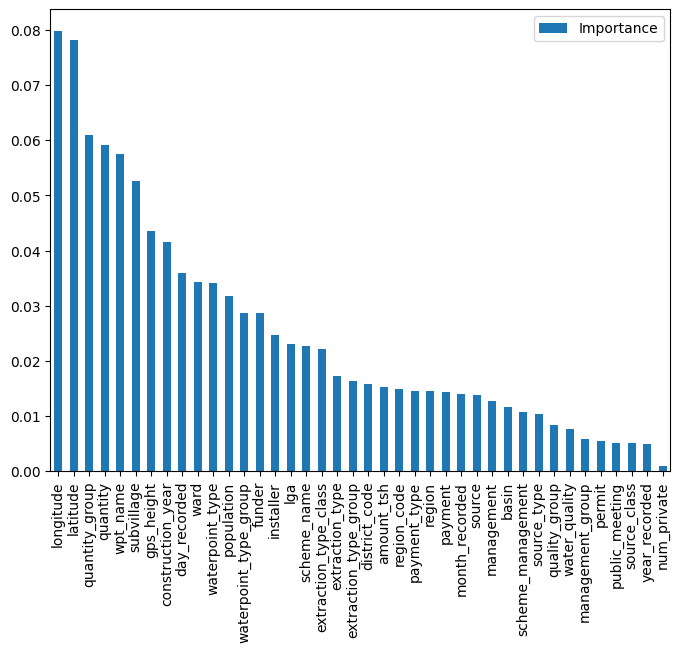

In [57]:
feat_importances = pd.DataFrame(model1.feature_importances_, index=X_train1.columns, columns=["Importance"])
feat_importances.sort_values(by='Importance', ascending=False, inplace=True)
feat_importances.plot(kind='bar', figsize=(8,6))

Creamos una función que haga el preprocesado para los datos nuevos que predeciremos.

In [58]:
def preprocess(var):
    # Clasificamos por tipo de variabla
    lista_num=['amount_tsh', 'gps_height', 'longitude', 'latitude', 'num_private', 'region_code', 'district_code',
                'population', 'construction_year']
    lista_cat=['funder', 'installer', 'wpt_name', 'basin', 'subvillage', 'region', 'lga', 'ward', 'recorded_by', 
                   'scheme_management', 'scheme_name', 'extraction_type', 'extraction_type_group', 'extraction_type_class', 
                   'management', 'management_group', 'payment', 'payment_type', 'water_quality', 'quality_group', 
                   'quantity', 'quantity_group', 'source', 'source_type', 'source_class', 'waterpoint_type', 
                   'waterpoint_type_group']
    lista_bin = ['public_meeting','permit']
    
    # Cambiamos tipo de dato
    var['date_recorded'] = pd.to_datetime(var['date_recorded'], infer_datetime_format=True)

    # Eliminamos variable recorded_by porque tiene un solo valor.
    var = var.drop(columns=['recorded_by'])
    
    # Pasamos a missing valores incorrectos.
    var['amount_tsh'] = var['amount_tsh'].replace(0, np.nan)
    var['gps_height'] = var['gps_height'] = np.where(var['gps_height'] <=0, np.nan, var['gps_height'])
    var['latitude'] = var['latitude'].replace(0, np.nan)
    var['longitude'] = var['longitude'].replace(0, np.nan)
    var['population'] = var['population'].replace(0, np.nan)
    var['construction_year'] = var['construction_year'].replace(0, np.nan)
    
    # Creamos variables adicionales
    var['year_recorded'] = var['date_recorded'].dt.year
    var['month_recorded'] = var['date_recorded'].dt.month 
    var['day_recorded'] = var['date_recorded'].dt.day 
    
    for i in lista_bin:
        var[i] = [1 if x == True else 0 for x in var[i]]
        
    # Tratar outliers
    df_out = var[['amount_tsh', 'gps_height']]
    
    # Aplicamos la gestión de outliers en modelo winsor.
    dfwinsor = df_out.apply(lambda x: gestiona_outliers(x,clas='winsor'))
    
    # Juntamos columnas con join
    dfin = var.drop(columns=['amount_tsh', 'gps_height'])
    dfwins = dfwinsor.join(dfin)
    
    # Imputaciones
    imp_cat = dfwins[['funder', 'installer', 'subvillage', 'scheme_management', 'scheme_name']]
    imp_cont = dfwins[['amount_tsh', 'gps_height', 'longitude', 'population', 'construction_year']]
    
    dfwins = dfwins.drop(columns=['funder', 
                                  'installer', 
                                  'subvillage', 
                                  'scheme_management', 
                                  'scheme_name', 
                                  'amount_tsh', 
                                  'gps_height', 
                                  'longitude', 
                                  'population', 
                                  'construction_year'
                                 ])
    
    
    import sklearn.impute as skl_imp
    import feature_engine.imputation as fe_imp

    # Moda: Solo nominales
    imputer_moda = skl_imp.SimpleImputer(strategy='most_frequent', missing_values=np.nan)

    # Mediana: solo numéricas
    imputer_median = fe_imp.MeanMedianImputer(imputation_method='median')

    median_imp = imputer_median.fit(imp_cont).transform(imp_cont)
    moda_imp = pd.DataFrame(imputer_moda.fit_transform(imp_cat),columns=imp_cat.columns)
    
    # Dataset depurado con la configuracion seleccionada mediana+moda
    df_med_mod = pd.concat([dfwins,median_imp,moda_imp], axis=1)
    
    # Transformación a numéricas
    df_med_mod['quantity'] = df_med_mod['quantity'].replace(('enough','insufficient','dry','seasonal', 'unknown'),
                              (1,2,3,4,5))
    df_med_mod['quantity_group'] = df_med_mod['quantity_group'].replace(('enough','insufficient','dry','seasonal', 'unknown'),
                                  (1,2,3,4,5))
    df_med_mod['source_class'] = df_med_mod['source_class'].replace(('groundwater','surface','unknown'),
                                  (1,2,3))
    df_med_mod['payment'] = df_med_mod['payment'].replace(('never pay','pay per bucket','pay monthly','unknown','pay when scheme fails','pay annually','other'),
                            (1,2,3,4,5,6,7))
    df_med_mod['payment_type'] = df_med_mod['payment_type'].replace(('never pay','per bucket','monthly','unknown','on failure','annually','other'),
                                  (1,2,3,4,5,6,7))

    
    # Label encoder para tratar las variables categóricas
    le = LabelEncoder()
    lista_le =['funder', 'installer', 'wpt_name', 'basin', 'subvillage', 'region', 'lga', 'ward', 'scheme_management', 
           'scheme_name', 'extraction_type', 'extraction_type_group', 'extraction_type_class', 'management', 
           'management_group', 'water_quality', 'quality_group', 'source', 'source_type', 'waterpoint_type', 
           'waterpoint_type_group']
    
    for i in lista_le:
        le.fit(df_med_mod[i].unique())
        df_med_mod[i] = le.transform(df_med_mod[i])
        
    df_med_mod = df_med_mod.drop(columns=['date_recorded'])

    return df_med_mod


Aplicamos el modelo a los nuevos datos

In [59]:
df_test1 = preprocess(test)

amount_tsh
gps_height


In [60]:
tst_id1 = df_test1['id']
df_test1.drop(columns=['id'], inplace=True)

In [61]:
y_prd1 = model1.predict(df_test1)
y_prd1

array([0, 1, 1, ..., 1, 1, 0], dtype=int64)

In [62]:
y_predicted1 = pd.DataFrame(y_prd1, columns = ['status_group'])

In [63]:
output1 = pd.concat([tst_id1, y_predicted1], axis=1)

In [64]:
output1['status_group'] = output1['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair')))  

In [65]:
output1.to_csv('Submission1.csv', index=False)  

En la primera aproximación, realizamos lo siguiente: 
1. Un preprocesado rápido, con corrección de tipo de dato, agregamos variables, sacamos las que tenían un solo valor.
2. Tratamiento de outliers con winsorize.
3. Pasamos a valores numéricos ciertos factores con pocas categorías
4. Utilizamos label encoder para variables categóricas con muchos valores diferentes.
5. Imputamos missings categóricas por moda y numéricas por mediana.
6. Entrenamos RFC sin parámetros, con el 80% de nuestro set de train, para sacar métricas.

El classification rate obtenido es de 81.54

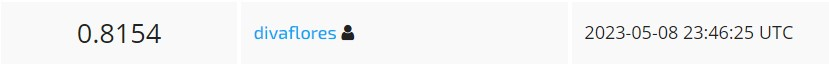

### Segunda iteración

En la segunda aproximación, imputaremos las variables continuas por knn.

In [66]:
knn_imputed = pd.DataFrame(imputer_knn.fit_transform(imp_cont),columns=imp_cont.columns)
knn_imputed.head()

,amount_tsh,gps_height,longitude,population,construction_year
0,6000.000000,1390.000000,34.938093,109.0,1999.000000
1,633.333333,1399.000000,34.698766,280.0,2010.000000
2,25.000000,686.000000,37.460664,250.0,2009.000000
3,670.000000,263.000000,38.486161,58.0,1986.000000
4,3000.000000,1435.666667,31.130847,117.0,1986.666667


Dataset depurado con la configuracion seleccionada knn+moda

In [67]:
df_knn_moda = pd.concat([df_wins,knn_imputed,moda_imputed], axis=1)

In [68]:
df_knn_moda.apply(lambda x: x.isna().sum()/df_knn_moda.shape[0]*100)

id                       0.0
date_recorded            0.0
latitude                 0.0
wpt_name                 0.0
num_private              0.0
basin                    0.0
region                   0.0
region_code              0.0
district_code            0.0
lga                      0.0
ward                     0.0
public_meeting           0.0
permit                   0.0
extraction_type          0.0
extraction_type_group    0.0
extraction_type_class    0.0
management               0.0
management_group         0.0
payment                  0.0
payment_type             0.0
water_quality            0.0
quality_group            0.0
quantity                 0.0
quantity_group           0.0
source                   0.0
source_type              0.0
source_class             0.0
waterpoint_type          0.0
waterpoint_type_group    0.0
status_group             0.0
trn                      0.0
year_recorded            0.0
month_recorded           0.0
day_recorded             0.0
amount_tsh    

Realizamos el mismo preprocesado de la primera aproximación.

#### Preprocesado rápido

Transformamos a numéricas

In [69]:
df_knn_moda['quantity'].replace(('enough','insufficient','dry','seasonal', 'unknown'),
                      (1,2,3,4,5),inplace=True)

df_knn_moda['quantity_group'].replace(('enough','insufficient','dry','seasonal', 'unknown'),
                      (1,2,3,4,5),inplace=True)

df_knn_moda['source_class'].replace(('groundwater','surface','unknown'),
                      (1,2,3),inplace=True)

df_knn_moda['payment'].replace(('never pay','pay per bucket','pay monthly','unknown','pay when scheme fails','pay annually','other'),
                      (1,2,3,4,5,6,7),inplace=True)

df_knn_moda['payment_type'].replace(('never pay','per bucket','monthly','unknown','on failure','annually','other'),
                      (1,2,3,4,5,6,7),inplace=True)

Elegimos utilizar el label encoder para tratar las variables categóricas

In [70]:
le = LabelEncoder()

In [71]:
for i in lista_le:
    le.fit(df_knn_moda[i].unique())
    df_knn_moda[i] = le.transform(df_knn_moda[i])

In [72]:
df_knn_moda.head(5)

,id,date_recorded,latitude,wpt_name,num_private,basin,region,region_code,district_code,lga,ward,public_meeting,permit,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group,trn,year_recorded,month_recorded,day_recorded,amount_tsh,gps_height,longitude,population,construction_year,funder,installer,subvillage,scheme_management,scheme_name
0,69572,2011-03-14,-9.856322,45683,0,1,3,11,5,51,1429,1,0,3,1,0,7,4,6,6,6,2,1,1,8,6,1,1,1,1,1,2011,3,14,6000.000000,1390.000000,34.938093,109.0,1999.000000,1548,1706,13116,7,2388
1,8776,2013-03-06,-2.147466,45426,0,4,9,20,2,103,1581,0,1,3,1,0,11,4,1,1,6,2,2,2,5,3,2,1,1,1,1,2013,3,6,633.333333,1399.000000,34.698766,280.0,2010.000000,522,610,17596,2,644
2,34310,2013-02-25,-3.821329,17767,0,5,8,21,4,108,1629,1,1,3,1,0,7,4,2,2,6,2,1,1,0,1,2,2,1,1,1,2013,2,25,25.000000,686.000000,37.460664,250.0,2009.000000,924,2296,10096,7,2261
3,67743,2013-01-28,-11.155298,45537,0,7,12,90,63,87,1576,1,1,14,10,5,7,4,1,1,6,2,3,3,3,0,1,2,1,0,1,2013,1,28,670.000000,263.000000,38.486161,58.0,1986.000000,1961,2078,9998,7,644
4,19728,2011-07-13,-1.825359,43411,0,4,4,18,1,26,1692,1,1,3,1,0,1,1,1,1,6,2,4,4,5,3,2,1,1,1,1,2011,7,13,3000.000000,1435.666667,31.130847,117.0,1986.666667,20,133,8583,7,644


Separamos nuevamente nuestros datasets de entrenamiento y prueba.

In [73]:
df_trn2 = df_knn_moda[df_knn_moda['trn']==1]
df_tst2 = df_knn_moda[df_knn_moda['trn']==0]

In [74]:
trn_id2 = df_trn2['id']
trn_varObj2 = df_trn2['status_group']
df_trn2.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy2 = df_trn2.copy()
df_trn2.drop(columns=['status_group'], inplace=True)

#### Muestreo estratificado

In [75]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(df_trn2,
                                                    trn_varObj2,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = trn_varObj2)

#### Modelos

In [76]:
model2 = RandomForestClassifier().fit(X_train2,y_train2)
y_pred2 = model2.predict(X_test2)

In [77]:
print('Matriz de confusión')
print(confusion_matrix(y_test2, y_pred2))

Matriz de confusión
[[3589  910   66]
 [ 511 5785  156]
 [ 140  433  290]]


In [78]:
print(classification_report(y_test2, y_pred2))

              precision    recall  f1-score   support

           0       0.85      0.79      0.82      4565
           1       0.81      0.90      0.85      6452
           2       0.57      0.34      0.42       863

    accuracy                           0.81     11880
   macro avg       0.74      0.67      0.70     11880
weighted avg       0.81      0.81      0.81     11880



En términos de score, vemos que esta segunda aproximación, predice un poco peor que la primera, con F1-score menor para la clase functional needs repair.

Aplicamos el modelo a los nuevos datos

In [79]:
tst_id2 = df_tst2['id']
tst_id2 = tst_id2.reset_index(drop=True)
tst_varObj2 = df_tst2['status_group']
df_tst2.drop(columns=['id','date_recorded', 'trn'], inplace=True)
tst_copy2 = df_tst2.copy()
df_tst2.drop(columns=['status_group'], inplace=True)

In [80]:
y_prd2 = model2.predict(df_tst2)
y_prd2

array([0, 2, 1, ..., 1, 1, 0], dtype=int64)

In [81]:
y_predicted2 = pd.DataFrame(y_prd2, columns = ['status_group'])

In [82]:
output2 = pd.concat([tst_id2, y_predicted2], axis=1)

In [83]:
output2['status_group'] = output2['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair')))  

In [84]:
output2.to_csv('Submission2.csv', index=False)  

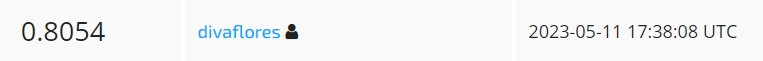

Como ya lo habíamos visto en las métricas, el classification rate baja un poco, llegando a 81.19

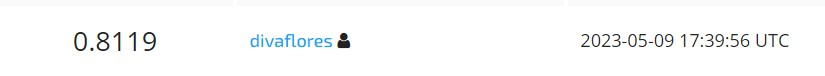

### Tercera iteración

En la tercera aproximación, intentaremos mejorar el modelo creando variables por rangos, utilizando el dataset de imputaciones por mediana.

Luego haremos la selección de variables que más correlan con la variable objetivo.

In [85]:
df3 = df_median_moda.copy()

#### Feature Engineering

Eliminamos variable num_private, con casi el 99% de valores cero (missing)

In [86]:
df3.drop(columns=['num_private'], inplace=True)

Veamos los rangos que pueden ser creados para mejorar el modelo.

In [87]:
df3_prop = df3.drop(columns=['id', 'date_recorded', 'trn'])

In [88]:
def proporciones_final (var,target,df):

    proporcion = pd.DataFrame()
    
    proporcion['%depositos'] = df[target].groupby(df[var]).mean()*100
    proporcion['Conteo'] = df[target].groupby(df[var]).count()
    proporcion= proporcion.round(3)   
    proporcion_filtered = proporcion[(proporcion['%depositos']>0) & (proporcion['Conteo']>10)]
        
    if len(proporcion_filtered)<100 and len(proporcion_filtered)>1:
        fig = plt.figure()
        ax = proporcion_filtered['Conteo'].plot(kind='bar',grid=True)
                
        ax2 = ax.twinx()
        ax2.plot(proporcion_filtered['%depositos'].values, linestyle='-', linewidth=2.0,color='g')
        plt.tight_layout()        
    else:        
        proporcion_filtered.reset_index(inplace=True)
        sns.lmplot(x = var,y ='%depositos',data=proporcion_filtered, fit_reg=True,ci=None)    


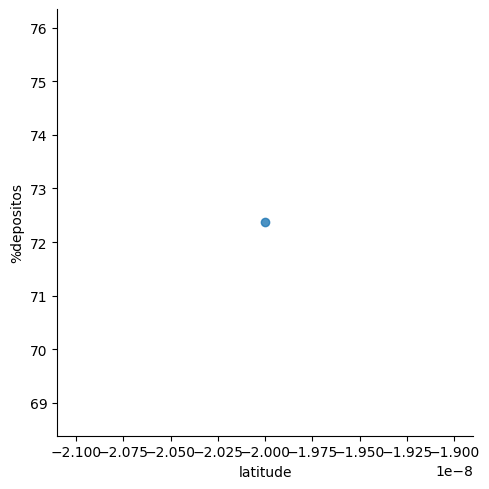

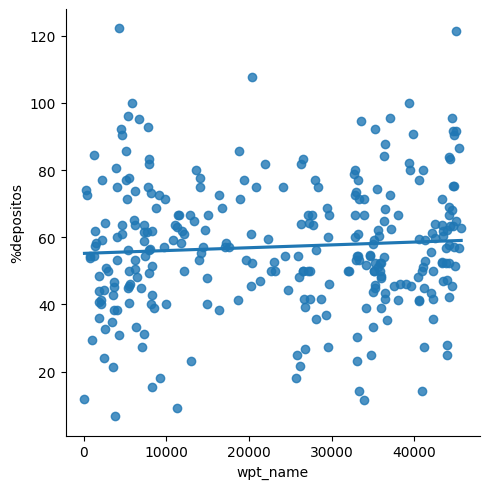

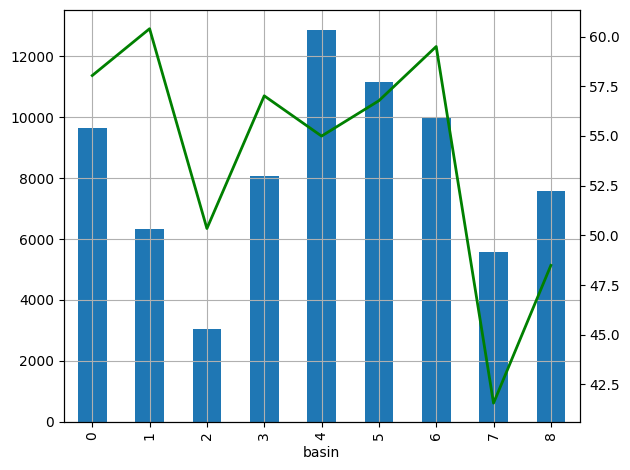

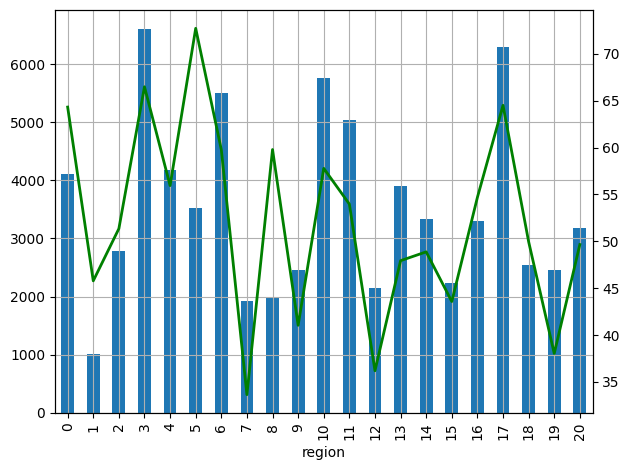

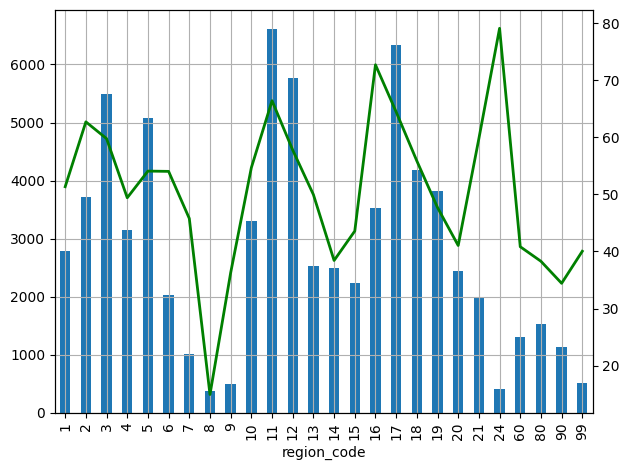

...

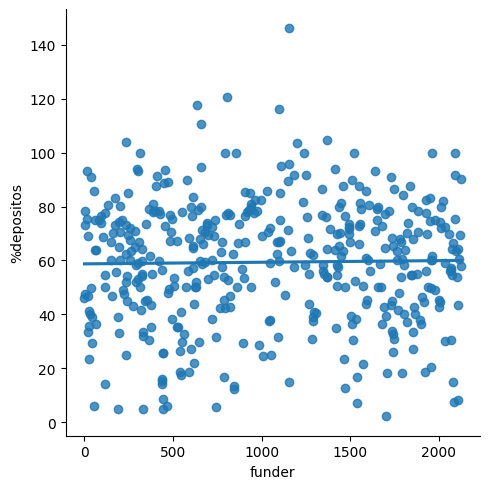

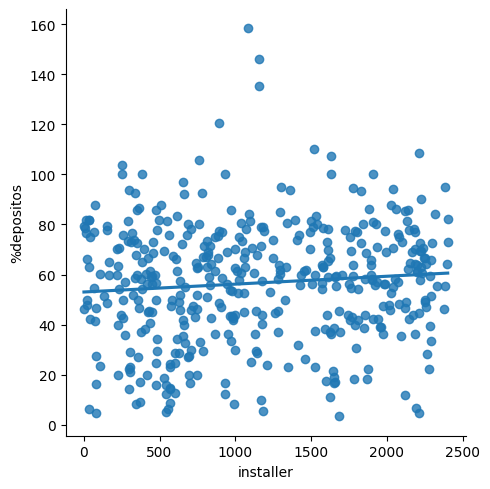

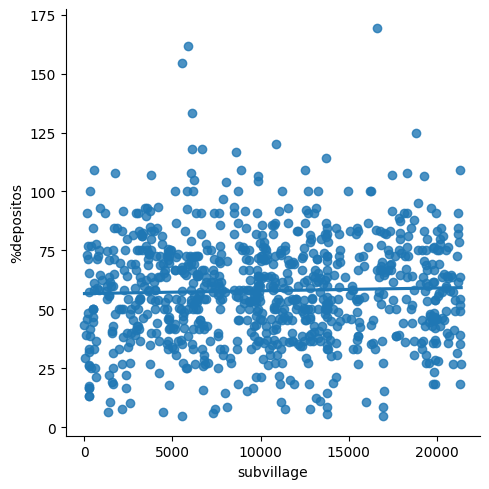

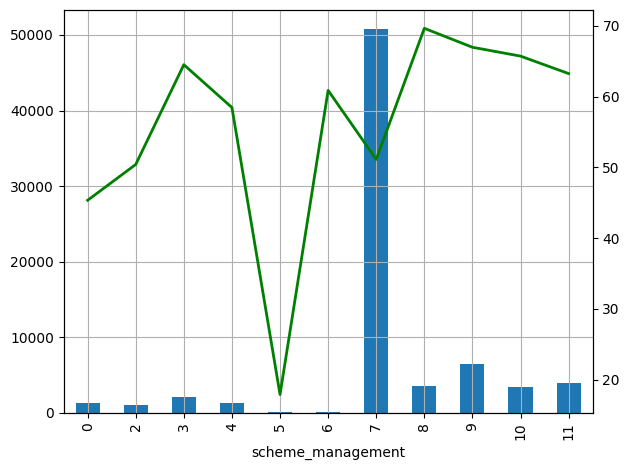

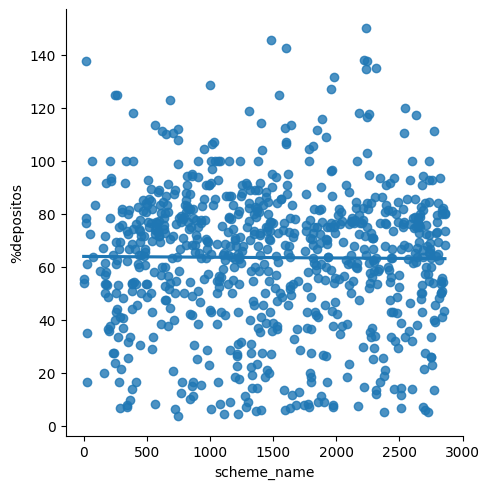

In [89]:
for i in df3_prop.columns:
    proporciones_final (i, 'status_group', df3_prop)

In [90]:
def tramos(varib,varib_destino,tamanio,maximo,df):
    df[varib_destino]=np.where(df[varib]==0,-1,(df[varib]//tamanio)*tamanio)
    df[varib_destino]=np.where(df[varib_destino]>=maximo,maximo,df[varib_destino])

In [91]:
# GPS_HEIGHT: hacemos tramos de la variable
tramos('gps_height','gps_height_new',500,3000,df3)
df3['gps_height_new'] = df3['gps_height_new'].apply(lambda x: 0 if x<=0 else x)

# POPULATION: hacemos tramos de la variable
tramos('population','population_new',500,5000,df3)
df3['population_new'] = df3['population_new'].apply(lambda x: 0 if x<=0 else x)

# EXTRACTION_TYPE_CLASS: la mayoria de los datos estan en dos categorias, creamos una nueva clase para el resto 
df3['extraction_type_class_new'] = df3['extraction_type_class'].apply(lambda x: 0 if x==0 else (1 if x==1 else(2))) 

# MANAGEMENT: Casi el 70% de los datos tienen un solo valor, creamos una variable binaria
df3['management_vwc_new'] = df3['management'].apply(lambda x: 1 if x==7 else 0)

# MANAGEMENT_GROUP: Casi el 90% de los datos tienen un solo valor, creamos una variable binaria
df3['management_group_usr_new'] = df3['management_group'].apply(lambda x: 1 if x==4 else 0)

# WATER_QUALITY: Casi el 90% de los datos tienen un solo valor, creamos una variable binaria
df3['water_quality_soft_new'] = df3['water_quality'].apply(lambda x: 1 if x==6 else 0)

# QUALITY_GROUP: Casi el 90% de los datos tienen un solo valor, creamos una variable binaria
df3['quality_group_good_new'] = df3['quality_group'].apply(lambda x: 1 if x==2 else 0)

# SOURCE: Los datos se concentran en tres categorias, creamos una cuarta para otros
df3['source_new'] = df3['source'].apply(lambda x: 0 if x==3 else (1 if x==6 else(2 if x==7 else(3 if x==8 else(4)))))

# SOURCE_TYPE: Los datos se concentran en tres categorias, creamos una cuarta para otros
df3['source_type_new'] = df3['source_type'].apply(lambda x: 0 if x==0 else (1 if x==4 else(2 if x==5 else(3 if x==6 else(4)))))

# WATERPOINT_TYPE: Los datos se concentran en dos categorias, creamos una tercera para otros
df3['waterpoint_type_new'] = df3['waterpoint_type'].apply(lambda x: 0 if x==1 else (1 if x==4 else(2)))

# WATERPOINT_TYPE_group: Los datos se concentran en dos categorias, creamos una tercera para otros
df3['waterpoint_type_group_new'] = df3['waterpoint_type_group'].apply(lambda x: 0 if x==1 else (1 if x==3 else(2)))

# SCHEME_MANAGEMENT: Mas del 60% de los datos tienen un solo valor, creamos una variable binaria
df3['scheme_management_vwc_new'] = df3['scheme_management'].apply(lambda x: 1 if x==7 else 0)


In [92]:
corr = abs(df3.corr())
corr[['status_group']].sort_values(by = 'status_group',ascending = False).style.background_gradient()

,status_group
status_group,1.000000
trn,0.456611
extraction_type_class_new,0.195237
quantity_group,0.176097
quantity,0.176097
waterpoint_type_new,0.169048
extraction_type_class,0.160136
waterpoint_type_group,0.157139
waterpoint_type,0.154592
waterpoint_type_group_new,0.150477


Vemos que algunas de las variables creadas adquieren mayor importancia en relación con la variable objetivo.

In [93]:
list(corr[['status_group']].sort_values(by = 'status_group',ascending = False).index)

['status_group',
 'trn',
 'extraction_type_class_new',
 'quantity_group',
 'quantity',
 'waterpoint_type_new',
 'extraction_type_class',
 'waterpoint_type_group',
 'waterpoint_type',
 'waterpoint_type_group_new',
 'construction_year',
 'quality_group',
 'extraction_type_group',
 'extraction_type',
 'quality_group_good_new',
 'water_quality_soft_new',
 'scheme_management_vwc_new',
 'management_vwc_new',
 'source',
 'gps_height',
 'payment_type',
 'payment',
 'gps_height_new',
 'source_type',
 'lga',
 'source_type_new',
 'region_code',
 'region',
 'source_class',
 'management',
 'scheme_management',
 'amount_tsh',
 'district_code',
 'public_meeting',
 'basin',
 'longitude',
 'source_new',
 'funder',
 'latitude',
 'month_recorded',
 'scheme_name',
 'installer',
 'wpt_name',
 'year_recorded',
 'population',
 'water_quality',
 'permit',
 'ward',
 'population_new',
 'subvillage',
 'id',
 'day_recorded',
 'management_group_usr_new',
 'management_group']

#### Selección de variables

In [94]:
final_features = ['extraction_type_class_new',
 'quantity_group',
 'quantity',
 'waterpoint_type_new',
 'extraction_type_class',
 'waterpoint_type_group',
 'waterpoint_type',
 'waterpoint_type_group_new',
 'construction_year',
 'quality_group',
 'extraction_type_group',
 'extraction_type',
 'quality_group_good_new',
 'water_quality_soft_new',
 'scheme_management_vwc_new', 
 'management_vwc_new',
 'source',
 'gps_height',
 'payment_type',
 'payment']

Separamos nuevamente nuestros datasets de entrenamiento y prueba.

In [95]:
df_trn3 = df3[df3['trn']==1]
df_tst3 = df3[df3['trn']==0]

In [96]:
trn_id3 = df_trn3['id']
trn_varObj3 = df_trn3['status_group']
df_trn3.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy3 = df_trn3.copy()
df_trn3.drop(columns=['status_group'], inplace=True)

#### Muestreo estratificado

In [97]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(df_trn3[final_features],
                                                    trn_varObj3,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = trn_varObj3)

In [98]:
model3 = RandomForestClassifier().fit(X_train3,y_train3)
y_pred3 = model3.predict(X_test3)

In [99]:
print(classification_report(y_test3, y_pred3))

              precision    recall  f1-score   support

           0       0.79      0.73      0.76      4565
           1       0.77      0.86      0.81      6452
           2       0.40      0.22      0.28       863

    accuracy                           0.76     11880
   macro avg       0.65      0.60      0.62     11880
weighted avg       0.75      0.76      0.75     11880



Podemos ver que las métricas, salen peor para las tres clases, comparando con las primeras dos aproximaciones.

Igualmente, probemos predecir con los datos nuevos.

In [100]:
tst_id3 = df_tst3['id']
tst_id3 = tst_id3.reset_index(drop=True)
tst_varObj3 = df_tst3['status_group']
df_tst3.drop(columns=['id','date_recorded', 'trn'], inplace=True)
tst_copy3 = df_tst3.copy()
df_tst3.drop(columns=['status_group'], inplace=True)

In [101]:
y_prd3 = model3.predict(df_tst3[final_features])
y_prd3

array([1, 1, 1, ..., 1, 1, 0], dtype=int64)

In [102]:
y_predicted3 = pd.DataFrame(y_prd3, columns = ['status_group'])

In [103]:
output3 = pd.concat([tst_id3, y_predicted3], axis=1)

In [104]:
output3['status_group'] = output3['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair')))  

In [207]:
output3.to_csv('Submission3.csv', index=False)  

Como ya lo suponíamos, el score alcanzado es de solo 76.38, mucho menor que los anteriores.

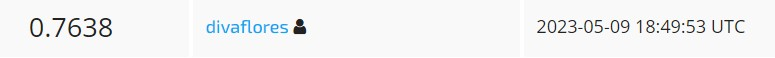

### Cuarta iteración

Eliminaremos variables que son parecidas y elegiremos las variables con SelectKBest. Utilizaremos el dataset de imputaciones por mediana.

In [105]:
df4 = df_median_moda.copy()

Separamos los datasets de entrenamiento y prueba.

In [106]:
df_trn4 = df4[df4['trn']==1]
df_tst4 = df4[df4['trn']==0]

In [107]:
df4_obj = df4['status_group']
df4.drop(columns=['region_code', 'extraction_type_group', 'management_group', 'payment_type', 'quality_group', 
                  'quantity_group', 'source_type', 'waterpoint_type_group', 'status_group', 'date_recorded', 'trn'], inplace=True)

In [108]:
selection = SelectKBest(k = 20)
feature_selection = selection.fit_transform(df4, df4_obj)

variables = list(np.asarray(list(df4))[selection.get_support()])
variables.sort()
print(variables)

['amount_tsh', 'basin', 'construction_year', 'district_code', 'extraction_type', 'extraction_type_class', 'gps_height', 'latitude', 'lga', 'longitude', 'management', 'payment', 'public_meeting', 'quantity', 'region', 'scheme_management', 'source', 'source_class', 'waterpoint_type', 'year_recorded']


In [109]:
trn_id4 = df_trn4['id']
trn_varObj4 = df_trn4['status_group']
df_trn4.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy4 = df_trn4.copy()
df_trn4.drop(columns=['status_group'], inplace=True)

#### Muestreo estratificado

In [110]:
X_train4, X_test4, y_train4, y_test4 = train_test_split(df_trn4[variables],
                                                    trn_varObj4,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = trn_varObj4)

In [111]:
model4 = RandomForestClassifier().fit(X_train4,y_train4)
y_pred4 = model4.predict(X_test4)

In [112]:
print(classification_report(y_test4, y_pred4))

              precision    recall  f1-score   support

           0       0.83      0.80      0.81      4565
           1       0.82      0.87      0.84      6452
           2       0.50      0.36      0.42       863

    accuracy                           0.80     11880
   macro avg       0.71      0.67      0.69     11880
weighted avg       0.80      0.80      0.80     11880



Las métricas no son mejores, mejoraron un poco respecto a la tercera aproximación, pero no alcanzan a la primera ni a la segunda.

Igualmente, predigamos los valores para el nuevo dataset. 

In [113]:
tst_id4 = df_tst4['id']
tst_id4 = tst_id4.reset_index(drop=True)
tst_varObj4 = df_tst4['status_group']
df_tst4.drop(columns=['id','date_recorded', 'trn'], inplace=True)
tst_copy4 = df_tst4.copy()
df_tst4.drop(columns=['status_group'], inplace=True)

In [114]:
y_prd4 = model4.predict(df_tst4[variables])
y_prd4

array([0, 1, 1, ..., 1, 1, 0], dtype=int64)

In [115]:
y_predicted4 = pd.DataFrame(y_prd4, columns = ['status_group'])

In [116]:
output4 = pd.concat([tst_id4, y_predicted4], axis=1)

In [117]:
output4['status_group'] = output4['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair')))  

In [208]:
output4.to_csv('Submission4.csv', index=False)  

Como ya lo habiamos visto en las métricas, el classification rate alcanzado es de 80.18, mejor que el tercer modelo, pero peor que los dos primeros.

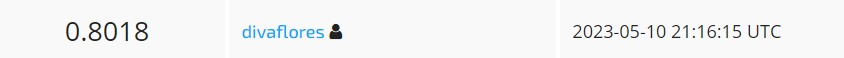

### Quinta iteración

Tuneo de hiperparámetros del modelo 1.

Utilizamos el mismo dataset que depuramos para el modelo 1.

In [118]:
df5 = df_median_moda.copy()

Separamos nuestros datasets de entrenamiento y prueba.

In [119]:
df_trn5 = df5[df5['trn']==1]
df_tst5 = df5[df5['trn']==0]

In [120]:
trn_id5 = df_trn5['id']
trn_varObj5 = df_trn5['status_group']
df_trn5.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy5 = df_trn5.copy()
df_trn5.drop(columns=['status_group'], inplace=True)

#### Muestreo estratificado

In [121]:
X_train5, X_test5, y_train5, y_test5 = train_test_split(df_trn5,
                                                    trn_varObj5,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = trn_varObj5)

#### Modelos

In [122]:
model5 = RandomForestClassifier().fit(X_train5,y_train5)
y_pred5 = model5.predict(X_test5)

In [123]:
grid_param = {
    'n_estimators': [30, 50, 100, 200],
    'criterion': ['gini', 'entropy'],
    'bootstrap': [True, False],
    'max_depth': [15,18,20]
}

In [124]:
model_grid = GridSearchCV(estimator=model5,
                     param_grid=grid_param,
                     scoring='f1',
                     cv=5,
                     n_jobs=-1)

In [125]:
model_grid.fit(X_train5, y_train5)
print(model_grid.best_params_)
print(model_grid.best_score_)

{'bootstrap': True, 'criterion': 'gini', 'max_depth': 15, 'n_estimators': 30}
nan


In [126]:
model52 = RandomForestClassifier(bootstrap=True, criterion='gini', max_depth=15, n_estimators=30).fit(X_train5,y_train5)
y_pred52 = model52.predict(X_test5)

In [127]:
print(classification_report(y_test5, y_pred5))

              precision    recall  f1-score   support

           0       0.84      0.80      0.82      4565
           1       0.82      0.89      0.85      6452
           2       0.55      0.34      0.42       863

    accuracy                           0.82     11880
   macro avg       0.74      0.68      0.70     11880
weighted avg       0.81      0.82      0.81     11880



Aún con el tuning de hiperparámetros, no supera al primer modelo en scoring.

Vamos a predecir con los datos nuevos.

In [128]:
tst_id5 = df_tst5['id']
tst_id5 = tst_id5.reset_index(drop=True)
tst_varObj5 = df_tst5['status_group']
df_tst5.drop(columns=['id','date_recorded', 'trn'], inplace=True)
tst_copy5 = df_tst5.copy()
df_tst5.drop(columns=['status_group'], inplace=True)

In [129]:
y_prd52 = model52.predict(df_tst5)
y_prd52

array([0, 1, 0, ..., 1, 1, 0], dtype=int64)

In [130]:
y_predicted52 = pd.DataFrame(y_prd52, columns = ['status_group'])

In [131]:
output5 = pd.concat([tst_id5, y_predicted52], axis=1)

In [132]:
output5['status_group'] = output5['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair')))  

In [209]:
output5.to_csv('Submission5.csv', index=False)  

El scoring alcanzado es de 80.48. Aún no logramos mejorar nuestro mejor score.

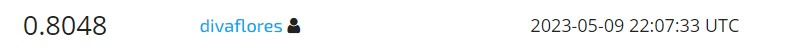

### Sexta iteración

Utilizamos autoML para explorar otras soluciones y ver si podemos mejorar nuestro primer modelo.

Utilizamos el dataset preprocesado del primer modelo, ya que pycaret no puede resolver variables categóricas.

In [133]:
df6 = trn_copy.copy()

In [134]:
import pycaret
from pycaret.classification import *

In [135]:
model_setup = setup(data=df6, target='status_group', session_id=1)

,Description,Value
0,Session id,1
1,Target,status_group
2,Target type,Multiclass
3,Original data shape,"(59400, 41)"
4,Transformed data shape,"(59400, 41)"
5,Transformed train set shape,"(41580, 41)"
6,Transformed test set shape,"(17820, 41)"
7,Numeric features,40
8,Preprocess,True
9,Imputation type,simple


In [136]:
models()

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron....,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


Comparamos los modelos.

In [137]:
best_models = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.8046,0.9045,0.8046,0.7981,0.7976,0.6339,0.6373,0.6360
xgboost,Extreme Gradient Boosting,0.7980,0.9007,0.7980,0.7945,0.7864,0.6147,0.6233,0.5870
et,Extra Trees Classifier,0.7936,0.8955,0.7936,0.7870,0.7889,0.6179,0.6191,0.8990
lightgbm,Light Gradient Boosting Machine,0.7910,0.8939,0.7910,0.7911,0.7772,0.5982,0.6103,0.5330
gbc,Gradient Boosting Classifier,0.7524,0.8578,0.7524,0.7578,0.7298,0.5140,0.5365,0.5130
dt,Decision Tree Classifier,0.7360,0.7673,0.7360,0.7386,0.7372,0.5243,0.5243,0.5860
ada,Ada Boost Classifier,0.7199,0.8029,0.7199,0.7071,0.6939,0.4500,0.4685,0.4660
lda,Linear Discriminant Analysis,0.6677,0.7499,0.6677,0.6498,0.6427,0.3503,0.3622,0.4310
ridge,Ridge Classifier,0.6676,0.0000,0.6676,0.6195,0.6360,0.3446,0.3576,0.4240
lr,Logistic Regression,0.6060,0.6627,0.6060,0.5642,0.5570,0.1984,0.2256,0.6480


El que parece tener mejor desempeño es el modelo Random Forest Classifier, que es el mismo algoritmo que ya habíamos utilizado previamente. Aunque las métricas son un poquito más bajas que nuestro mejor modelo, por ejemplo, el F1-score que habíamos obtenido era de 80.7 en comparación a 79.76 del mejor modelo del autoML.

In [138]:
model_rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8141,0.9031,0.8141,0.8077,0.8077,0.6526,0.6554
1,0.8148,0.9099,0.8148,0.8079,0.8082,0.6542,0.6566
2,0.8018,0.9041,0.8018,0.7941,0.7946,0.6292,0.6320
3,0.8011,0.9051,0.8011,0.7944,0.7950,0.6289,0.6315
4,0.8054,0.9061,0.8054,0.7984,0.7968,0.6334,0.6382
5,0.8035,0.9056,0.8035,0.7974,0.7953,0.6304,0.6341
6,0.8006,0.9058,0.8006,0.7952,0.7935,0.6254,0.6299
7,0.8009,0.8977,0.8009,0.7953,0.7949,0.6277,0.6309
8,0.8045,0.9043,0.8045,0.7976,0.7977,0.6343,0.6374


Parece no estar sobreajustando el modelo, ya que para cada partición tiene valores similares.

In [139]:
print(model_rf)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=1, verbose=0, warm_start=False)


Como está utilizando hiperparámetros por defecto, trataremos de mejorarlos.

In [140]:
tune_model_rf = tune_model(model_rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7148,0.8063,0.7148,0.6889,0.6768,0.4245,0.4664
1,0.7256,0.8175,0.7256,0.6948,0.6895,0.4490,0.4858
2,0.7112,0.7991,0.7112,0.6802,0.6737,0.4189,0.4560
3,0.7193,0.8041,0.7193,0.6917,0.6817,0.4345,0.4752
4,0.7068,0.8082,0.7068,0.6856,0.6675,0.4063,0.4522
5,0.7253,0.8122,0.7253,0.6972,0.6887,0.4474,0.4871
6,0.7054,0.7950,0.7054,0.6769,0.6671,0.4059,0.4452
7,0.7090,0.7940,0.7090,0.6825,0.6701,0.4121,0.4543
8,0.7114,0.7955,0.7114,0.6821,0.6733,0.4185,0.4579


Fitting 10 folds for each of 10 candidates, totalling 100 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


El modelo tuneado parece tener peor performance que el que usa hiperparámetros por defecto.

### Séptima iteración

Utilicemos el segundo mejor algoritmo que nos recomendó el autoML: XGBoost.

Utilizaremos nuestro dataset depurado en el modelo 1.

In [141]:
df7 = df_median_moda.copy()

Separamos nuestros datasets de entrenamiento y prueba.

In [142]:
df_trn7 = df7[df7['trn']==1]
df_tst7 = df7[df7['trn']==0]

In [143]:
trn_id7 = df_trn7['id']
trn_varObj7 = df_trn7['status_group']
df_trn7.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy7 = df_trn7.copy()
df_trn7.drop(columns=['status_group'], inplace=True)


#### Muestreo estratificado

In [144]:
X_train7, X_test7, y_train7, y_test7 = train_test_split(df_trn7,
                                                    trn_varObj7,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = trn_varObj7)

#### Modelos

In [145]:
model7 = XGBClassifier(objective="multi:softprob", random_state=42)
model7.fit(X_train7, y_train7)
y_pred7 = model7.predict(X_test7)

In [146]:
print(classification_report(y_test7, y_pred7))

              precision    recall  f1-score   support

           0       0.84      0.75      0.79      4565
           1       0.78      0.91      0.84      6452
           2       0.65      0.26      0.37       863

    accuracy                           0.80     11880
   macro avg       0.76      0.64      0.67     11880
weighted avg       0.80      0.80      0.79     11880



Las métricas no son mejores que el primer modelo.

Igualmente, predigamos los valores para el nuevo dataset. 

In [147]:
tst_id7 = df_tst7['id']
tst_id7 = tst_id7.reset_index(drop=True)
tst_varObj7 = df_tst7['status_group']
df_tst7.drop(columns=['id','date_recorded', 'trn'], inplace=True)
tst_copy7 = df_tst7.copy()
df_tst7.drop(columns=['status_group'], inplace=True)

In [148]:
y_prd7 = model7.predict(df_tst7)
y_prd7

array([1, 1, 1, ..., 1, 1, 0], dtype=int64)

In [149]:
y_predicted7 = pd.DataFrame(y_prd7, columns = ['status_group'])

In [150]:
output7 = pd.concat([tst_id7, y_predicted7], axis=1)

In [151]:
output7['status_group'] = output7['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair')))  

In [210]:
output7.to_csv('Submission7.csv', index=False)  

El score alcanzado es de 80.42, aún no mejor que el mayor score alcanzado con la primera aproximación.

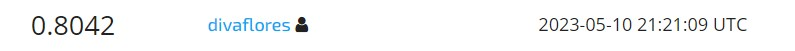

### Octava iteración

Intentaremos depurar mejor nuestro dataset en pos de mejorar un poco más el modelo.

Reutilizamos el dataset semidepurado del modelo 1 y aplicamos sobre el mismo algunos cambios más.

In [152]:
df8 = df1_copy.copy()

Eliminamos todas las variables que sean similares a otras.

In [153]:
df8.drop(columns=['extraction_type_group', 'management_group', 'payment_type', 'quality_group', 
                  'quantity_group', 'source_type', 'waterpoint_type_group'], inplace=True)

Eliminamos variables geográficas, dejamos solo latitud y longitud.

In [154]:
df8.drop(columns=['basin', 'subvillage', 'region', 'region_code', 'district_code', 'lga', 'ward'], inplace=True)

Eliminamos la variable num_private, que tiene casi el 99% de sus valores perdidos.

In [155]:
df8.drop(columns=['num_private'], inplace=True)

Construimos una variable ordinal a partir del año de construcción.

In [156]:
df8['year_ordinal']= df8['construction_year']-df8['construction_year'].min()
df8.drop(columns=['construction_year'], inplace=True)

Pasaremos a dummies todas las categorías que tengan hasta 10 valores distintos. Las que tengan más, las pasaremos a numéricas.

In [157]:
df8_cat = df8.select_dtypes(exclude=np.number)
df8_num = df8.select_dtypes(include=np.number)
to_dummies = list(df8_cat.loc[:,df8_cat.nunique() <= 10])
to_number = list(df8_cat.loc[:,df8_cat.nunique() > 10])

In [158]:
def encode_and_bind(original_dataframe, feature_to_encode):
    dummies = pd.get_dummies(original_dataframe[feature_to_encode])
    return(dummies) 

In [159]:
df_dummies = encode_and_bind(df8, to_dummies)
df8.drop(columns=to_dummies, inplace=True)

In [160]:
le = LabelEncoder()

In [161]:
for i in to_number:
    le.fit(df8[i].unique())
    df8[i] = le.transform(df8[i])

In [162]:
df8 = pd.concat([df8, df_dummies], axis=1)

Separamos nuevamente nuestros datasets de entrenamiento y prueba.

In [163]:
df_trn8 = df8[df8['trn']==1]
df_tst8 = df8[df8['trn']==0]

In [164]:
trn_id8 = df_trn8['id']
trn_varObj8 = df_trn8['status_group']
df_trn8.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy8 = df_trn8.copy()
df_trn8.drop(columns=['status_group'], inplace=True)

#### Muestreo estratificado

In [165]:
X_train8, X_test8, y_train8, y_test8 = train_test_split(df_trn8,
                                                    trn_varObj8,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = trn_varObj8)

#### Modelos

In [166]:
model8 = RandomForestClassifier().fit(X_train8,y_train8)
y_pred8 = model8.predict(X_test8)

In [167]:
print('Matriz de confusión')
print(confusion_matrix(y_test8, y_pred8))

Matriz de confusión
[[3597  902   66]
 [ 529 5755  168]
 [ 145  408  310]]


In [168]:
print(classification_report(y_test8, y_pred8))

              precision    recall  f1-score   support

           0       0.84      0.79      0.81      4565
           1       0.81      0.89      0.85      6452
           2       0.57      0.36      0.44       863

    accuracy                           0.81     11880
   macro avg       0.74      0.68      0.70     11880
weighted avg       0.81      0.81      0.81     11880



Aplicamos el modelo a los nuevos datos

In [169]:
tst_id8 = df_tst8['id']
tst_id8 = tst_id8.reset_index(drop=True)
tst_varObj8 = df_tst8['status_group']
df_tst8.drop(columns=['id','date_recorded', 'trn'], inplace=True)
tst_copy8 = df_tst8.copy()
df_tst8.drop(columns=['status_group'], inplace=True)

In [170]:
y_prd8 = model8.predict(df_tst8)
y_prd8

array([1, 2, 1, ..., 1, 1, 0], dtype=int64)

In [171]:
y_predicted8 = pd.DataFrame(y_prd8, columns = ['status_group'])

In [172]:
output8 = pd.concat([tst_id8, y_predicted8], axis=1)

In [173]:
output8['status_group'] = output8['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair'))) 

In [174]:
output8.to_csv('Submission8.csv', index=False)  

El score alcanzado es de 81.38

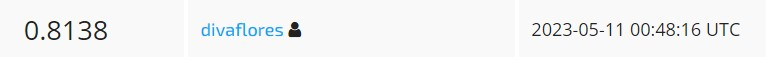

### Novena iteración

Intentaremos hacer un oversampling de la clase minoritaria, a ver si podemos mejorar las métricas de esta clase.

Reutilizamos el dataset depurado del modelo 8.

In [175]:
df9 = df8.copy()

Separamos nuevamente nuestros datasets de entrenamiento y prueba.

In [176]:
df_trn9 = df9[df9['trn']==1]
df_tst9 = df9[df9['trn']==0]

In [177]:
print("Before OverSampling, counts of label 'functional': {}".format(sum(df_trn9['status_group']==1)))
print("Before OverSampling, counts of label 'non functional': {}".format(sum(df_trn9['status_group']==0)))
print("Before OverSampling, counts of label 'functional needs repair': {} \n".format(sum(df_trn9['status_group']==2)))

sm = SMOTE(random_state=2,sampling_strategy='minority')
df9_res, y_df9_res = sm.fit_resample(df_trn9.drop('status_group',axis=1), df_trn9['status_group'].ravel())

print('After OverSampling, the shape of train_X: {}'.format(df9_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_df9_res.shape))

print("After OverSampling, counts of label 'functional': {}".format(sum(y_df9_res==1)))
print("After OverSampling, counts of label 'non functional': {}".format(sum(y_df9_res==0)))
print("After OverSampling, counts of label 'functional needs repair': {}".format(sum(y_df9_res==2)))

Before OverSampling, counts of label 'functional': 32259
Before OverSampling, counts of label 'non functional': 22824
Before OverSampling, counts of label 'functional needs repair': 4317 

After OverSampling, the shape of train_X: (87342, 68)
After OverSampling, the shape of train_y: (87342,) 

After OverSampling, counts of label 'functional': 32259
After OverSampling, counts of label 'non functional': 22824
After OverSampling, counts of label 'functional needs repair': 32259


In [178]:
trn_id9 = df9_res['id']
df9_res.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy9 = df9_res.copy()

In [179]:
X_train_res, X_test_res, y_train_res, y_test_res = train_test_split(df9_res,
                                                    y_df9_res,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = y_df9_res)

In [180]:
model9 = RandomForestClassifier().fit(X_train_res,y_train_res)
y_pred9 = model9.predict(X_test_res)

In [181]:
print(classification_report(y_test_res, y_pred9))

              precision    recall  f1-score   support

           0       0.85      0.79      0.82      4565
           1       0.82      0.88      0.85      6452
           2       0.95      0.92      0.93      6452

    accuracy                           0.87     17469
   macro avg       0.87      0.86      0.87     17469
weighted avg       0.87      0.87      0.87     17469



Las métricas mejoran bastante con respecto a nuestro mejor modelo, sobre todo de nuestra clase minoritaria, que alcanza un f1-score de 0.93.

Veamos si no está sobreajustando:

In [182]:
results = cross_val_score(estimator=model9, X=X_train_res, y=y_train_res, cv=5)

In [183]:
results

array([0.86432916, 0.86325581, 0.86325581, 0.8618148 , 0.86267354])

In [184]:
print(results.mean())

0.8630658245200069


In [185]:
print(results.std())

0.000823062746632314


Aparentemente, no hay overfitting.

Aplicamos el modelo entrenado a los nuevos datos para predecir.

In [186]:
tst_id9 = df_tst9['id']
tst_id9 = tst_id9.reset_index(drop=True)
tst_varObj9 = df_tst9['status_group']
df_tst9.drop(columns=['id','date_recorded', 'trn'], inplace=True)
tst_copy9 = df_tst9.copy()
df_tst9.drop(columns=['status_group'], inplace=True)

In [187]:
y_prd9 = model9.predict(df_tst9)
y_prd9

array([1, 1, 1, ..., 1, 1, 0], dtype=int64)

In [188]:
y_predicted9 = pd.DataFrame(y_prd9, columns = ['status_group'])

In [189]:
output9 = pd.concat([tst_id9, y_predicted9], axis=1)

In [190]:
output9['status_group'] = output9['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair'))) 

In [191]:
output9.to_csv('Submission9.csv', index=False)  

Aunque las métricas mejoran, a la hora de predecir no mejora el score. Esta vez el score alcanzado es de 81.06.

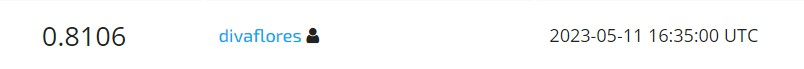

### Décima iteración

Como última aproximación, intentaremos mejorar el primer modelo, seleccionando las mejores variables utilizando feature selection.

In [192]:
df10 = df_median_moda.copy()
df_trn10 = df10[df10['trn']==1]
df_tst10 = df10[df10['trn']==0]

trn_id10 = df_trn10['id']
trn_varObj10 = df_trn10['status_group']
df_trn10.drop(columns=['id','date_recorded', 'trn'], inplace=True)
trn_copy10 = df_trn10.copy()
df_trn10.drop(columns=['status_group'], inplace=True)#### Muestreo estratificado

#### Muestreo estratificado

In [193]:
X_train10, X_test10, y_train10, y_test10 = train_test_split(df_trn10,
                                                    trn_varObj10,
                                                    test_size=0.2,
                                                    random_state=42,
                                                    stratify = trn_varObj10)

Filtramos las variables más importantes que obtuvimos del modelo 1.

In [194]:
from sklearn.feature_selection import SelectFromModel

rf_sfm = SelectFromModel(model1, threshold=0.02) 
rf_sfm = rf_sfm.fit(X_train10, y_train10)

Transformamos los datos para crear un nuevo dataset conteniendo solo las variables más importantes.

In [195]:
X_important_train = rf_sfm.transform(X_train10)
X_important_test = rf_sfm.transform(X_test10)

#### Modelos

In [196]:
model10 = RandomForestClassifier().fit(X_important_train,y_train10)
y_pred10 = model10.predict(X_important_test)

In [197]:
print('Matriz de confusión')
print(confusion_matrix(y_test10, y_pred10))

Matriz de confusión
[[3558  936   71]
 [ 574 5719  159]
 [ 156  425  282]]


In [198]:
print(classification_report(y_test10, y_pred10))

              precision    recall  f1-score   support

           0       0.83      0.78      0.80      4565
           1       0.81      0.89      0.85      6452
           2       0.55      0.33      0.41       863

    accuracy                           0.80     11880
   macro avg       0.73      0.66      0.69     11880
weighted avg       0.80      0.80      0.80     11880



#### Comparación de performance del modelo con y sin feature selection

In [199]:
rf_fscore = f1_score(y_test1, y_pred1, average='weighted')
rf_imp_fscore = f1_score(y_test10, y_pred10, average='weighted')

print('Baseline Model F1 Score::',("{:.2f}".format(rf_fscore*100)), "%")
print('Reduced Features Model F1 Score:',("{:.2f}".format(rf_imp_fscore*100)), "%")


Baseline Model F1 Score:: 80.93 %
Reduced Features Model F1 Score: 79.77 %


Aplicamos el modelo entrenado a los nuevos datos de test para predecir.

In [200]:
tst_id10 = df_tst10['id']
tst_id10 = tst_id10.reset_index(drop=True)
tst_varObj10 = df_tst10['status_group']
df_tst10.drop(columns=['id','date_recorded', 'trn'], inplace=True)
tst_copy10 = df_tst10.copy()
df_tst10.drop(columns=['status_group'], inplace=True)

Transformamos los datos para crear un nuevo dataset conteniendo solo las variables más importantes.

In [201]:
X_imp_test_new = rf_sfm.transform(df_tst10)

In [202]:
y_prd10 = model10.predict(X_imp_test_new)
y_prd10

array([0, 1, 1, ..., 1, 1, 0], dtype=int64)

In [203]:
y_predicted10 = pd.DataFrame(y_prd10, columns = ['status_group'])

In [204]:
output10 = pd.concat([tst_id10, y_predicted10], axis=1)

In [205]:
output10['status_group'] = output10['status_group'].apply(lambda x: 'functional' if x == 1
                                                                            else ('non functional' if x == 0  
                                                                                    else('functional needs repair'))) 

In [206]:
output10.to_csv('Submission10.csv', index=False)  

Como habíamos visto en la comparación de f1-score, el feature selection no mejora la predicción del modelo. El score obtenido es de 80.54.

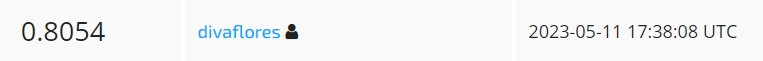

#### Resumen

   * Se han realizado varias aproximaciones, de las cuales se incluyen diez de ellas en este notebook.
   
   * En la primera aproximación, realizamos un preprocesado incluyendo lo siguiente: tratamiento de outliers, correcciones de tipos de datos, creación de nuevas variables, eliminación de variable con un solo valor. Además, pasamos a numéricos ciertos factores con pocas categorías; utilizamos label encoder para variables categóricas con muchos valores diferentes; imputamos missings categóricas por moda y numéricas por mediana; entrenamos RFC sin parámetros, con el 80% de nuestro set de train, para sacar métricas. El score obtenido es de 81.54.
   
   * En la segunda iteración, imputamos las variables continuas por knn. El score obtenido es de 81.19.
   
   * En la tercera iteración, intentamos mejorar el modelo creando variables por rangos, utilizando el dataset de imputaciones por mediana. Luego, hicimos la selección de variables que más correlan con la variable objetivo. El score obtenido es de 76.38.
   
   * En la cuarta iteración eliminamos variables que son parecidas a otras y elegimos las variables con SelectKBest. El score obtenido es de 80.18.
   
   * En la quinta iteración realizamos el tuneo de hiperparámetros del modelo 1. El score obtenido es de 80.48.
   
   * En la sexta iteración utilizamos autoML (PyCaret) para explorar otras soluciones y ver si podemos mejorar nuestro primer modelo.
   
   * En la séptima iteración utilicemos el segundo mejor algoritmo que nos recomendó el autoML: XGBoost. El score obtenido es de 80.42.
   
   * En la octava iteración intentamos depurar un poco más nuestro dataset en pos de mejorar el modelo. Realizamos lo siguiente: eliminamos variables similares a otras, eliminamos variables geograficas, dejamos solo las coordenadas, eliminamos variable con 99% de missing enmascarados, transformamos variables y pasamos a dummies todas las categorías que tienen hasta 10 valores distintos y las que tienen más, las pasamos a numéricas. El score obtenido es de 81.38.
   
   * En la novena iteración realizamos un oversampling de la clase minoritaria "functional needs repair". El score alcanzado es de 81.06.
   
   * La décima iteración intentamos mejorar el modelo seleccionando las mejores variables utilizando feature selection. El score obtenido es de 80.54.

Finalmente, elegimos el primer modelo como entregable, con mejor score entre todas las iteraciones.
    